In [ ]:
! pwd

/content


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


### Imports

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import random

import datetime
import operator
import os
from random import sample
import shutil
import itertools

import sklearn
assert sklearn.__version__ >= "0.20"
from sklearn.metrics import confusion_matrix
from sklearn import metrics
#from sklearn.dummy import DummyClassifier

from functools import partial
import tensorflow as tf
from tensorflow import keras
assert tf.__version__ >= "2.0"
from tensorflow.keras.callbacks import TensorBoard 
from tensorflow.keras.preprocessing.image import ImageDataGenerator 

### Load Models

In [ ]:
xception_model = keras.models.load_model('drive/MyDrive/capstone-3/models/xception_trained')

In [ ]:
rn50_model = keras.models.load_model('drive/MyDrive/capstone-3/models/rn50_trained')

In [ ]:
incep_model = keras.models.load_model('drive/MyDrive/capstone-3/models/incep_trained')

In [ ]:
rn34_model = keras.models.load_model('drive/MyDrive/capstone-3/models/rn34')

### Image Directories

In [ ]:
train_dir = 'drive/MyDrive/capstone-3/data/train'
val_dir = 'drive/MyDrive/capstone-3/data/val'
test_dir = 'drive/MyDrive/capstone-3/data/test'

### Image generation function

In [ ]:
def img_gen_train(train_dir,val_dir,test_dir,transform_kwargs,transform=True,prepro=None,target_size=(224,224),color_mode='rgb',class_mode='categorical',batch_size=32):

  '''
  functionalizes the ImageDataGenerator and flow_from_directory processes for the test, train and validation image sets

  Inputs:

  train_dir,val_dir,test_dir: directories to each image set
  transform_kwargs: Dictionary of kwargs for image transform settings
  transform: Whether or not to transform image sets
  prepro: What preprocessing_function to use for ImageDataGenerator, necessary if certain models are used. usually the name of the model
  target_size: desired length and width for images
  color_mode: color mode for images
  class_mode: class mode for images
  batch_size: batch size for image gen

  Outputs:

  train_imgs,val_imgs,test_imgs: image generator objects for train, val and test sets

  '''

  if transform == True:
    train_datagen = ImageDataGenerator(transform_kwargs,
                                      preprocessing_function=prepro)
    val_datagen = ImageDataGenerator(#rescale=1./255,
                                      preprocessing_function=prepro)
  else:
    train_datagen = ImageDataGenerator(preprocessing_function=prepro)
    val_datagen = ImageDataGenerator(preprocessing_function=prepro)    

  train_imgs = train_datagen.flow_from_directory(
                                  train_dir,
                                  target_size=target_size,
                                  color_mode=color_mode,
                                  batch_size=batch_size,
                                  class_mode=class_mode,
                                  interpolation='nearest')#might try bilinear

  val_imgs = val_datagen.flow_from_directory(
                                val_dir,
                                target_size=target_size,
                                color_mode=color_mode,
                                batch_size=batch_size,
                                class_mode=class_mode,
                                interpolation='nearest')#might try bilinear

  test_imgs = val_datagen.flow_from_directory(
                                test_dir,
                                target_size=target_size,
                                color_mode=color_mode,
                                batch_size=batch_size,
                                class_mode=class_mode,
                                interpolation='nearest',
                                seed=1111,
                                shuffle=False)#might try bilinear                                           

  return train_imgs,val_imgs,test_imgs


### Predict model on test set

In [ ]:
transform_kwargs = {#'rescale':1./255,
                    'featurewise_center':False,
                    'shear_range':0.2,
                    'zoom_range':0.2,
                    'horizontal_flip':True,
                    'featurewise_std_normalization':False,
                    'zca_whitening':True}

In [ ]:
train_set,val_set,test_set = img_gen_train(train_dir=train_dir,val_dir=val_dir,test_dir=test_dir,
                                                  transform_kwargs=transform_kwargs,
                                                  transform=True,
                                                  prepro=keras.applications.xception.preprocess_input,
                                                  target_size=(224,224),
                                                  color_mode='rgb',
                                                  batch_size=32)

Found 1330 images belonging to 6 classes.
Found 233 images belonging to 6 classes.
Found 273 images belonging to 6 classes.


In [ ]:
xception_preds = xception_model.predict(test_set)

### List Image Topics

In [ ]:
list_features = ['fabric_patterned','masonry','metal','stone','terrain','wood']
list_features_sub = ['concrete_plaster_surface','fabric_patterned','marble','masonry_blocks','masonry_bricks','masonry_cobblestone','masonry_pavement','masonry_roof_tiles','metal_scifi','metal_surface','rocks_surface','terrain_earth','terrain_lush','terrain_road','terrain_rocks','tiles_ceramic','wood_bark','wood_panel','wood_planks']
n_features = len(list_features)

### Unaltered version of test set for autoencoder

In [ ]:
test_unaltered = ImageDataGenerator(rescale=1./255).flow_from_directory(target_size=(224,224),class_mode='categorical',directory=test_dir,batch_size=273,seed=1111,shuffle=False)

Found 273 images belonging to 6 classes.


#### Image Generator Shape: [Batch], [X or Y], [Row]

In [ ]:
list_features

['fabric_patterned', 'masonry', 'metal', 'stone', 'terrain', 'wood']

##### Find indeces of the most confident predicted images per feature

In [ ]:
most_conf_preds = np.transpose(xception_preds.argsort(axis=0)[-5:][::-1])

most_conf_preds

array([[  4,   9,  63,   5,  17],
       [ 48,  74,  39,  19,  76],
       [108, 112, 110, 139, 111],
       [158, 146, 155, 161, 159],
       [223, 219, 237, 211, 192],
       [243, 247, 244, 253, 242]])

##### Tie prediction indecies to images from unaltered test set

In [ ]:
most_conf_fabric = most_conf_preds[0]
most_conf_masonry = most_conf_preds[1]
most_conf_metal = most_conf_preds[2]
most_conf_stone = most_conf_preds[3]
most_conf_terrain = most_conf_preds[4]
most_conf_wood = most_conf_preds[5]

In [ ]:
def tie_imgs_preds(preds,imgs):
  img_lst = []
  for pred in preds:
    img_lst.append(imgs[0][0][pred])
  return np.array(img_lst)


In [ ]:
most_conf_fabric

array([ 4,  9, 63,  5, 17])

In [ ]:
fab_conf_imgs = tie_imgs_preds(most_conf_fabric,test_unaltered)
mas_conf_imgs = tie_imgs_preds(most_conf_masonry,test_unaltered)
met_conf_imgs = tie_imgs_preds(most_conf_metal,test_unaltered)
stone_conf_imgs = tie_imgs_preds(most_conf_stone,test_unaltered)
terr_conf_imgs = tie_imgs_preds(most_conf_terrain,test_unaltered)
wood_conf_imgs = tie_imgs_preds(most_conf_wood,test_unaltered)

### Autoencoder Functions

In [ ]:
def rounded_accuracy(y_true, y_pred):
    return tf.keras.metrics.binary_accuracy(tf.round(y_true), tf.round(y_pred))

In [ ]:
K = tf.keras.backend

class Sampling(tf.keras.layers.Layer):
    def call(self, inputs):
        mean, log_var = inputs
        return K.random_normal(tf.shape(log_var)) * K.exp(log_var / 2) + mean

#### Set Random Seeds

In [ ]:
tf.random.set_seed(42)
np.random.seed(42)

codings_size = 10

#### Reset encoders

In [ ]:
variational_ae,variational_encoder,variational_decoder = None,None,None

#### Build Encoder Function

In [ ]:
input_shape=[224,224,3]

inputs = tf.keras.layers.Input(shape=input_shape)
z = tf.keras.layers.Flatten()(inputs)
z = tf.keras.layers.Dense(150, activation="selu")(z)
z = tf.keras.layers.Dense(100, activation="selu")(z)
codings_mean = tf.keras.layers.Dense(codings_size)(z)
codings_log_var = tf.keras.layers.Dense(codings_size)(z)
codings = Sampling()([codings_mean, codings_log_var])
variational_encoder = tf.keras.models.Model(inputs=[inputs], outputs=[codings_mean, codings_log_var, codings])

#### Build Decoder Function

In [ ]:
decoder_inputs = tf.keras.layers.Input(shape=[codings_size])
x = tf.keras.layers.Dense(100, activation="selu")(decoder_inputs)
x = tf.keras.layers.Dense(150, activation="selu")(x)
x = tf.keras.layers.Dense(np.prod(input_shape), activation="sigmoid")(x) #?
outputs = tf.keras.layers.Reshape(input_shape)(x) #?
variational_decoder = tf.keras.models.Model(inputs=[decoder_inputs], outputs=[outputs])

#### Combine Elements

In [ ]:
_, _, codings = variational_encoder(inputs)
reconstructions = variational_decoder(codings)
variational_ae = tf.keras.models.Model(inputs=[inputs], outputs=[reconstructions])

### Loss Function

In [ ]:
latent_loss = -0.5 * K.sum(
    1 + codings_log_var - K.exp(codings_log_var) - K.square(codings_mean),
    axis=-1)
variational_ae.add_loss(K.mean(latent_loss) / (224*224*3))

In [ ]:
variational_encoder.compile(loss='binary_crossentropy', optimizer=tf.keras.optimizers.Adam(learning_rate=1e-5), metrics=[rounded_accuracy])

In [ ]:
variational_ae.compile(loss='binary_crossentropy', optimizer=tf.keras.optimizers.Adam(learning_rate=1e-5), metrics=[rounded_accuracy])

In [ ]:
conf_imgs = np.array(conf_imgs)

In [ ]:
list_features

['fabric_patterned', 'masonry', 'metal', 'stone', 'terrain', 'wood']

### Generate Images For fabric_patterned

In [ ]:
fabric_variation_history = variational_ae.fit(fab_conf_imgs,fab_conf_imgs,epochs=300,batch_size=1)

Epoch 1/300
5/5 [==============================] - 1s 137ms/step - loss: 0.6933 - rounded_accuracy: 0.5006
Epoch 2/300
5/5 [==============================] - 1s 139ms/step - loss: 0.6933 - rounded_accuracy: 0.5028
Epoch 3/300
5/5 [==============================] - 1s 137ms/step - loss: 0.6931 - rounded_accuracy: 0.5102
Epoch 4/300
5/5 [==============================] - 1s 140ms/step - loss: 0.6929 - rounded_accuracy: 0.5202
Epoch 5/300
5/5 [==============================] - 1s 138ms/step - loss: 0.6925 - rounded_accuracy: 0.5317
Epoch 6/300
5/5 [==============================] - 1s 138ms/step - loss: 0.6919 - rounded_accuracy: 0.5476
Epoch 7/300
5/5 [==============================] - 1s 142ms/step - loss: 0.6911 - rounded_accuracy: 0.5595
Epoch 8/300
5/5 [==============================] - 1s 138ms/step - loss: 0.6897 - rounded_accuracy: 0.5801
Epoch 9/300
5/5 [==============================] - 1s 140ms/step - loss: 0.6884 - rounded_accuracy: 0.5970
Epoch 10/300
5/5 [===================

In [ ]:
_,_,fabric_enc_preds = variational_encoder.predict(fab_conf_imgs)

In [ ]:
fabric_enc_preds.shape

(5, 10)

In [ ]:
def random_enc_feature(preds,n_vars=10):
  rand_encs = []
  for _ in range(n_vars):
    rand_enc = np.append(random.randrange(-1,10),np.array(preds)[:,1:])
    rand_encs.append(rand_enc)
  return np.array(rand_encs)

In [ ]:
fabric_rand_encs = random_enc_feature(fabric_enc_preds)

In [ ]:
fabric_rand_encs = fabric_rand_encs.reshape(-1,10)

In [ ]:
fabric_dec_preds = variational_decoder.predict(fabric_rand_encs)

In [ ]:
fabric_dec_preds[0].shape

(224, 224, 3)

#### Generate Images

In [ ]:
def plot_multiple_images(images, n_cols=None):
    n_cols = n_cols or len(images)
    n_rows = (len(images) - 1) // n_cols + 1
    if images.shape[-1] == 1:
        images = np.squeeze(images, axis=-1)
    plt.figure(figsize=(20, 20))
    for index, image in enumerate(images):
        plt.subplot(n_rows, n_cols, index + 1)
        plt.imshow(image, cmap="binary")
        plt.axis("off")
    plt.tight_layout()

#### Will need some tweaking

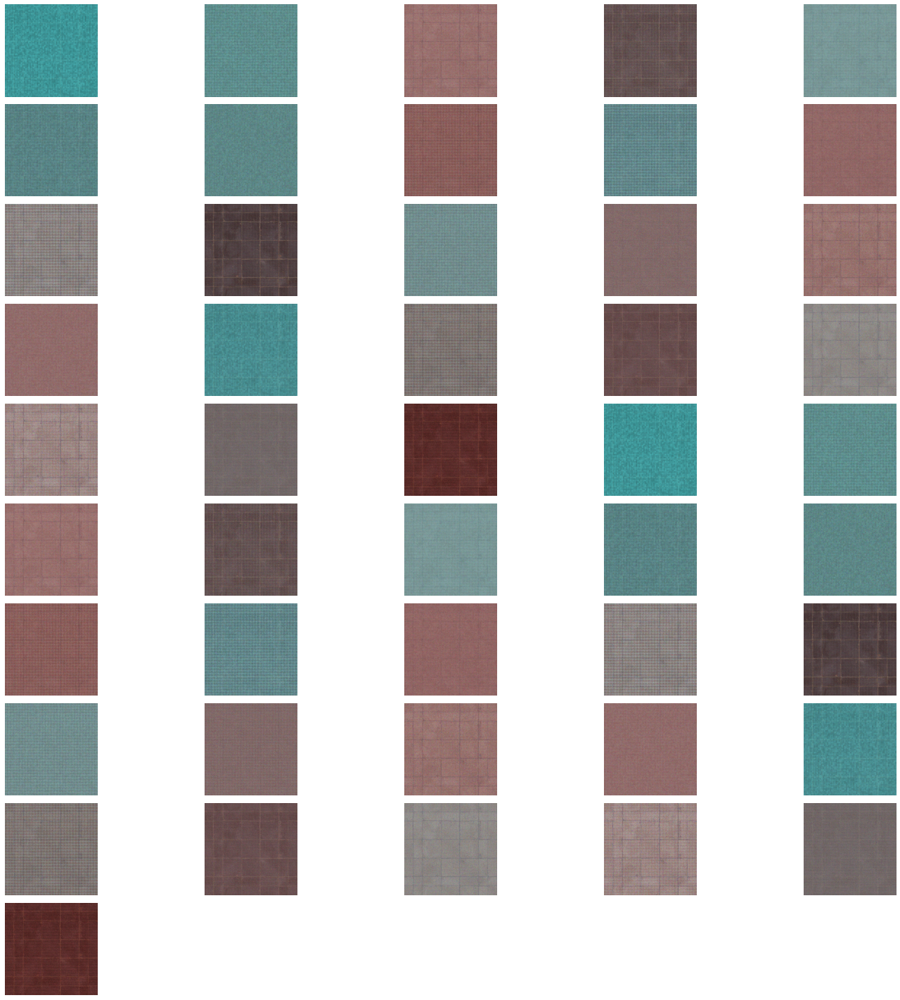

In [ ]:
plot_multiple_images(fabric_dec_preds,5)
#save_fig("vae_generated_images_plot", tight_layout=False)



### Generate Images For masonry

In [ ]:
masonry_variation_history = variational_ae.fit(mas_conf_imgs,mas_conf_imgs,epochs=1000,batch_size=1)

Epoch 1/1000
5/5 [==============================] - 2s 140ms/step - loss: 0.6934 - rounded_accuracy: 0.4995
Epoch 2/1000
5/5 [==============================] - 1s 145ms/step - loss: 0.6933 - rounded_accuracy: 0.4996
Epoch 3/1000
5/5 [==============================] - 1s 141ms/step - loss: 0.6933 - rounded_accuracy: 0.4985
Epoch 4/1000
5/5 [==============================] - 1s 144ms/step - loss: 0.6933 - rounded_accuracy: 0.4975
Epoch 5/1000
5/5 [==============================] - 1s 144ms/step - loss: 0.6932 - rounded_accuracy: 0.4991
Epoch 6/1000
5/5 [==============================] - 1s 137ms/step - loss: 0.6932 - rounded_accuracy: 0.5025
Epoch 7/1000
5/5 [==============================] - 1s 142ms/step - loss: 0.6932 - rounded_accuracy: 0.5020
Epoch 8/1000
5/5 [==============================] - 1s 146ms/step - loss: 0.6932 - rounded_accuracy: 0.5046
Epoch 9/1000
5/5 [==============================] - 1s 143ms/step - loss: 0.6932 - rounded_accuracy: 0.5081
Epoch 10/1000
5/5 [=========

In [ ]:
_,_,mas_enc_preds = variational_encoder.predict(mas_conf_imgs)

In [ ]:
mas_enc_preds.shape

(5, 10)

In [ ]:
mas_rand_encs = random_enc_feature(mas_enc_preds)

In [ ]:
mas_rand_encs = mas_rand_encs.reshape(-1,10)

In [ ]:
mas_dec_preds = variational_decoder.predict(mas_rand_encs)

In [ ]:
mas_dec_preds[0].shape

(224, 224, 3)

#### Generate Images

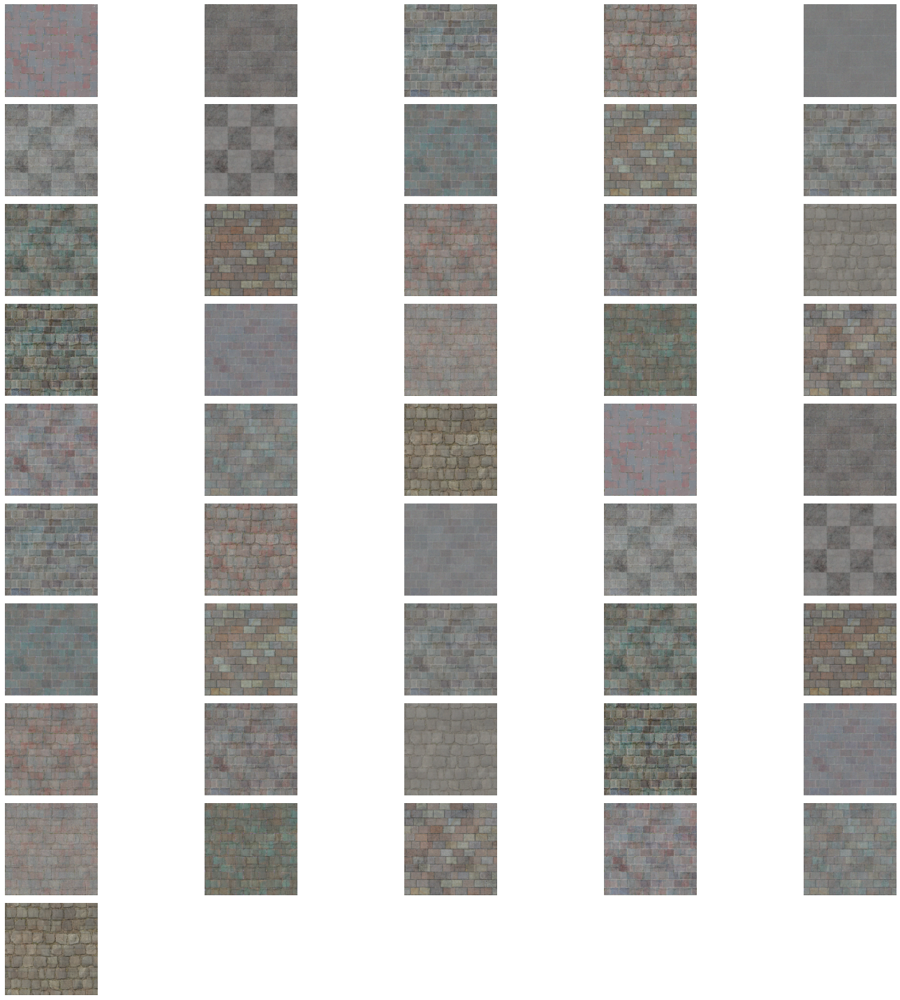

In [ ]:
plot_multiple_images(mas_dec_preds,5)
#save_fig("vae_generated_images_plot", tight_layout=False)



### Generate Images For metal

In [ ]:
metal_variation_history = variational_ae.fit(met_conf_imgs,met_conf_imgs,epochs=500,batch_size=1)

Epoch 1/500
5/5 [==============================] - 2s 140ms/step - loss: 0.6934 - rounded_accuracy: 0.5001
Epoch 2/500
5/5 [==============================] - 1s 138ms/step - loss: 0.6933 - rounded_accuracy: 0.4990
Epoch 3/500
5/5 [==============================] - 1s 140ms/step - loss: 0.6932 - rounded_accuracy: 0.5091
Epoch 4/500
5/5 [==============================] - 1s 138ms/step - loss: 0.6931 - rounded_accuracy: 0.5152
Epoch 5/500
5/5 [==============================] - 1s 138ms/step - loss: 0.6930 - rounded_accuracy: 0.5263
Epoch 6/500
5/5 [==============================] - 1s 140ms/step - loss: 0.6927 - rounded_accuracy: 0.5414
Epoch 7/500
5/5 [==============================] - 1s 136ms/step - loss: 0.6924 - rounded_accuracy: 0.5561
Epoch 8/500
5/5 [==============================] - 1s 140ms/step - loss: 0.6919 - rounded_accuracy: 0.5753
Epoch 9/500
5/5 [==============================] - 1s 139ms/step - loss: 0.6915 - rounded_accuracy: 0.5899
Epoch 10/500
5/5 [===================

In [ ]:
_,_,met_enc_preds = variational_encoder.predict(met_conf_imgs)

In [ ]:
met_enc_preds.shape

(5, 10)

In [ ]:
met_rand_encs = random_enc_feature(met_enc_preds)

In [ ]:
met_rand_encs = met_rand_encs.reshape(-1,10)

In [ ]:
met_dec_preds = variational_decoder.predict(met_rand_encs)

In [ ]:
met_dec_preds[0].shape

(224, 224, 3)

#### Generate Images

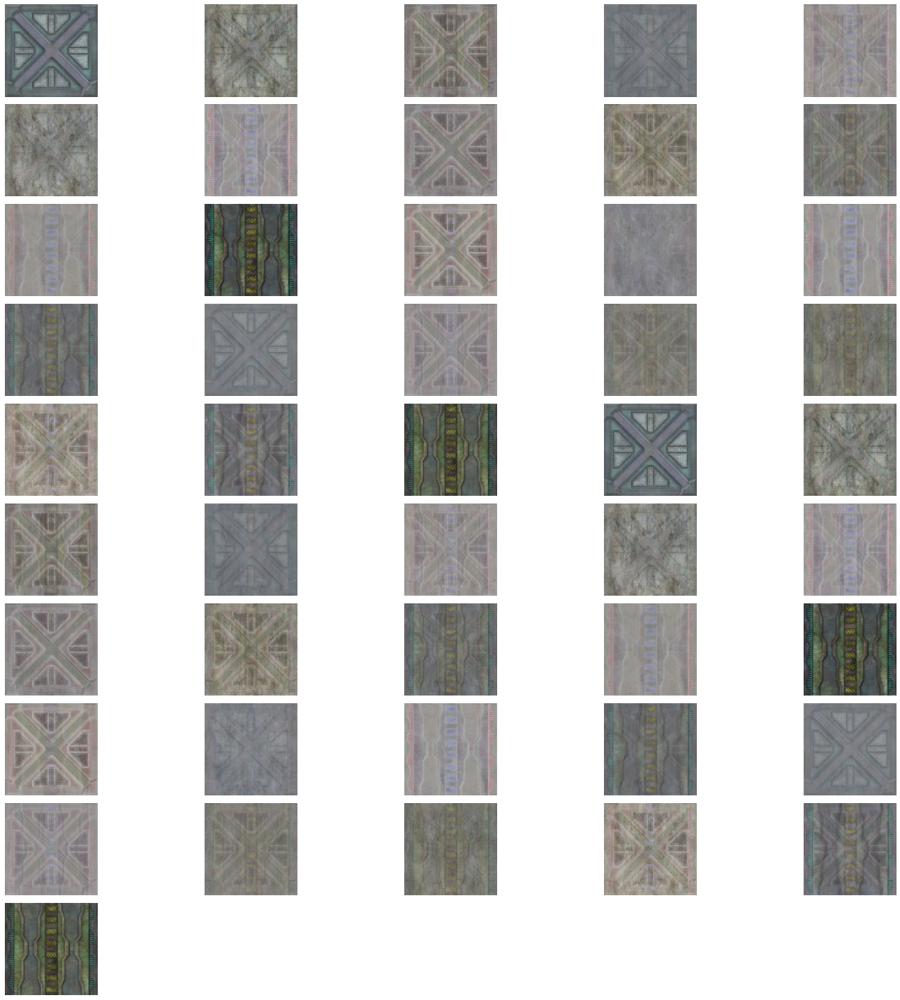

In [ ]:
plot_multiple_images(met_dec_preds,5)
#save_fig("vae_generated_images_plot", tight_layout=False)



### Generate Images For stone

In [ ]:
stone_variation_history = variational_ae.fit(stone_conf_imgs,stone_conf_imgs,epochs=500,batch_size=1)

Epoch 1/500
5/5 [==============================] - 2s 143ms/step - loss: 0.6933 - rounded_accuracy: 0.4990
Epoch 2/500
5/5 [==============================] - 1s 139ms/step - loss: 0.6933 - rounded_accuracy: 0.4990
Epoch 3/500
5/5 [==============================] - 1s 140ms/step - loss: 0.6933 - rounded_accuracy: 0.5001
Epoch 4/500
5/5 [==============================] - 1s 144ms/step - loss: 0.6932 - rounded_accuracy: 0.4996
Epoch 5/500
5/5 [==============================] - 1s 140ms/step - loss: 0.6932 - rounded_accuracy: 0.5069
Epoch 6/500
5/5 [==============================] - 1s 140ms/step - loss: 0.6931 - rounded_accuracy: 0.5155
Epoch 7/500
5/5 [==============================] - 1s 141ms/step - loss: 0.6931 - rounded_accuracy: 0.5068
Epoch 8/500
5/5 [==============================] - 1s 141ms/step - loss: 0.6928 - rounded_accuracy: 0.5243
Epoch 9/500
5/5 [==============================] - 1s 143ms/step - loss: 0.6927 - rounded_accuracy: 0.5157
Epoch 10/500
5/5 [===================

In [ ]:
_,_,stone_enc_preds = variational_encoder.predict(stone_conf_imgs)

In [ ]:
stone_enc_preds.shape

(5, 10)

In [ ]:
stone_rand_encs = random_enc_feature(stone_enc_preds)

In [ ]:
stone_rand_encs = stone_rand_encs.reshape(-1,10)

In [ ]:
stone_dec_preds = variational_decoder.predict(stone_rand_encs)

In [ ]:
stone_dec_preds[0].shape

(224, 224, 3)

#### Generate Images

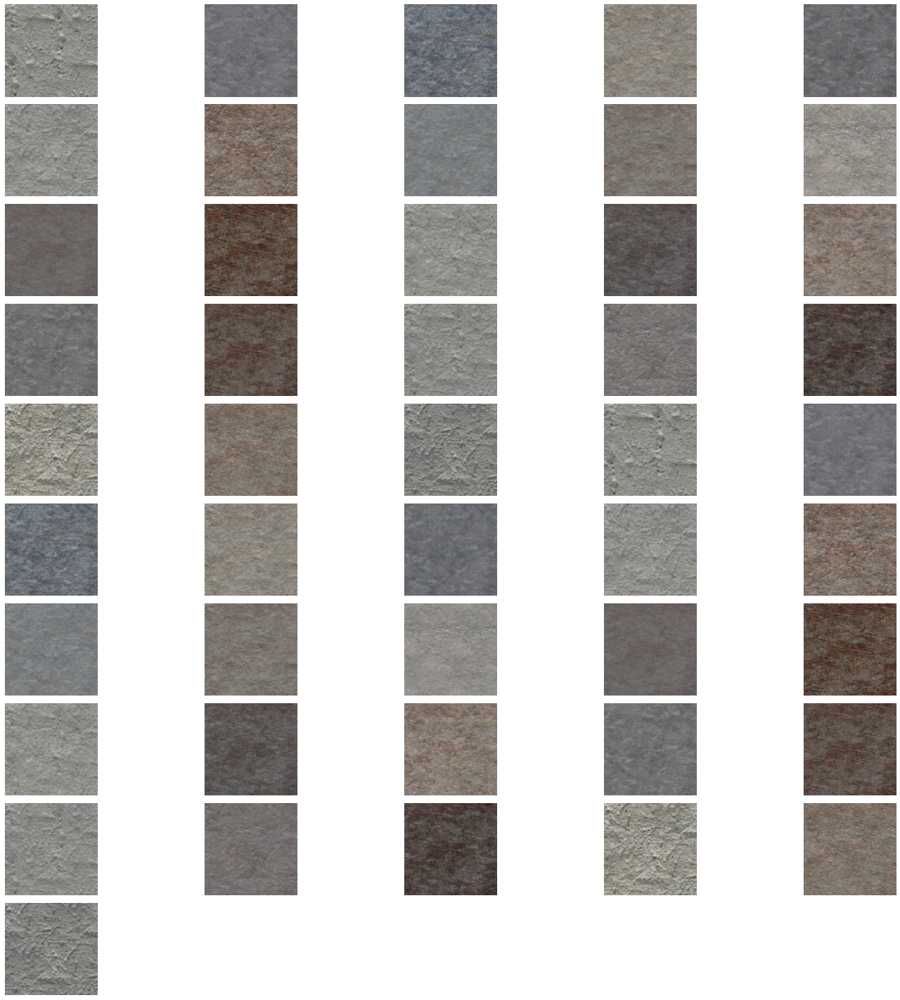

In [ ]:
plot_multiple_images(stone_dec_preds,5)
#save_fig("vae_generated_images_plot", tight_layout=False)



### Generate Images For terrain

In [ ]:
terr_variation_history = variational_ae.fit(terr_conf_imgs,terr_conf_imgs,epochs=500,batch_size=1)

Epoch 1/500
5/5 [==============================] - 2s 139ms/step - loss: 0.6933 - rounded_accuracy: 0.5016
Epoch 2/500
5/5 [==============================] - 1s 141ms/step - loss: 0.6933 - rounded_accuracy: 0.5026
Epoch 3/500
5/5 [==============================] - 1s 145ms/step - loss: 0.6930 - rounded_accuracy: 0.5122
Epoch 4/500
5/5 [==============================] - 1s 143ms/step - loss: 0.6927 - rounded_accuracy: 0.5227
Epoch 5/500
5/5 [==============================] - 1s 136ms/step - loss: 0.6923 - rounded_accuracy: 0.5327
Epoch 6/500
5/5 [==============================] - 1s 141ms/step - loss: 0.6917 - rounded_accuracy: 0.5450
Epoch 7/500
5/5 [==============================] - 1s 143ms/step - loss: 0.6911 - rounded_accuracy: 0.5555
Epoch 8/500
5/5 [==============================] - 1s 137ms/step - loss: 0.6900 - rounded_accuracy: 0.5703
Epoch 9/500
5/5 [==============================] - 1s 138ms/step - loss: 0.6889 - rounded_accuracy: 0.5866
Epoch 10/500
5/5 [===================

In [ ]:
_,_,terr_enc_preds = variational_encoder.predict(terr_conf_imgs)

In [ ]:
terr_enc_preds.shape

(5, 10)

In [ ]:
terr_rand_encs = random_enc_feature(terr_enc_preds)

In [ ]:
terr_rand_encs = terr_rand_encs.reshape(-1,10)

In [ ]:
terr_dec_preds = variational_decoder.predict(terr_rand_encs)

In [ ]:
terr_dec_preds[0].shape

(224, 224, 3)

#### Generate Images

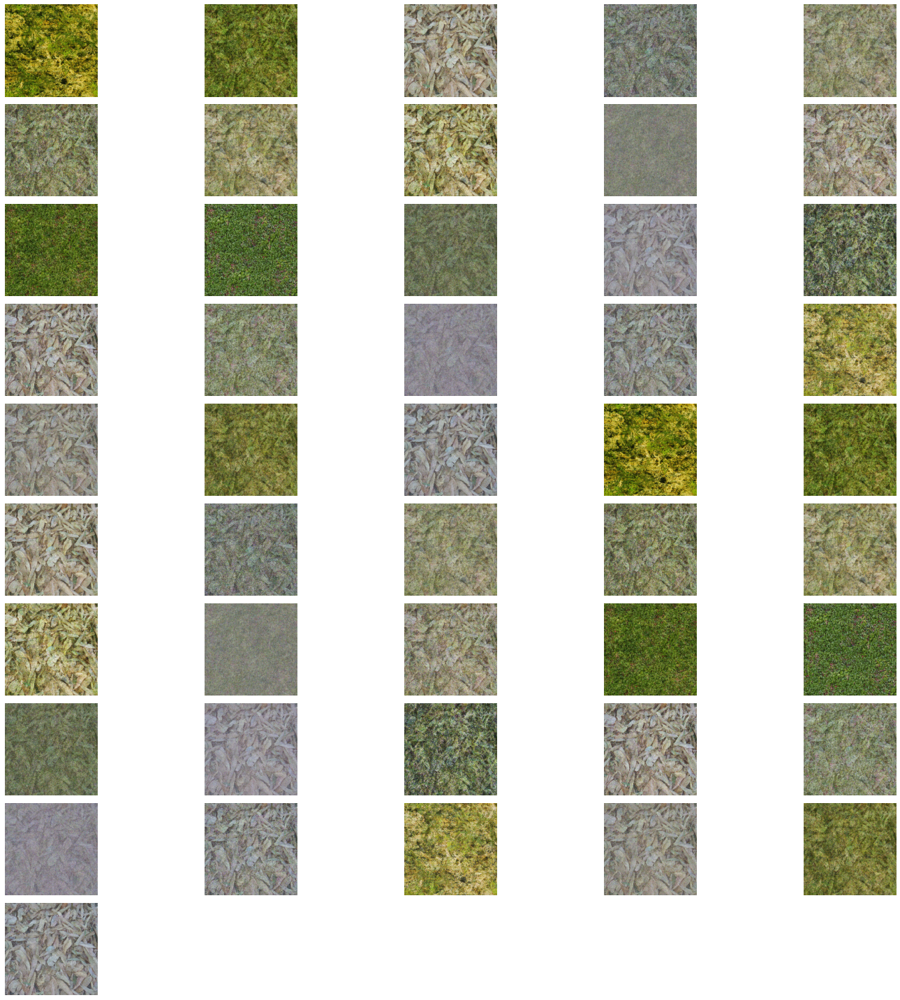

In [ ]:
plot_multiple_images(terr_dec_preds,5)
#save_fig("vae_generated_images_plot", tight_layout=False)



### Generate Images For wood

In [ ]:
wood_variation_history = variational_ae.fit(wood_conf_imgs,wood_conf_imgs,epochs=500,batch_size=1)

Epoch 1/500
5/5 [==============================] - 2s 144ms/step - loss: 0.6933 - rounded_accuracy: 0.4996
Epoch 2/500
5/5 [==============================] - 1s 143ms/step - loss: 0.6932 - rounded_accuracy: 0.5068
Epoch 3/500
5/5 [==============================] - 1s 144ms/step - loss: 0.6930 - rounded_accuracy: 0.5152
Epoch 4/500
5/5 [==============================] - 1s 140ms/step - loss: 0.6925 - rounded_accuracy: 0.5328
Epoch 5/500
5/5 [==============================] - 1s 145ms/step - loss: 0.6920 - rounded_accuracy: 0.5441
Epoch 6/500
5/5 [==============================] - 1s 140ms/step - loss: 0.6914 - rounded_accuracy: 0.5651
Epoch 7/500
5/5 [==============================] - 1s 142ms/step - loss: 0.6897 - rounded_accuracy: 0.5871
Epoch 8/500
5/5 [==============================] - 1s 145ms/step - loss: 0.6886 - rounded_accuracy: 0.6099
Epoch 9/500
5/5 [==============================] - 1s 144ms/step - loss: 0.6864 - rounded_accuracy: 0.6407
Epoch 10/500
5/5 [===================

In [ ]:
_,_,wood_enc_preds = variational_encoder.predict(wood_conf_imgs)

In [ ]:
wood_enc_preds.shape

(5, 10)

In [ ]:
wood_rand_encs = random_enc_feature(wood_enc_preds)

In [ ]:
wood_rand_encs = wood_rand_encs.reshape(-1,10)

In [ ]:
wood_dec_preds = variational_decoder.predict(wood_rand_encs)

In [ ]:
wood_dec_preds[0].shape

(224, 224, 3)

#### Generate Images

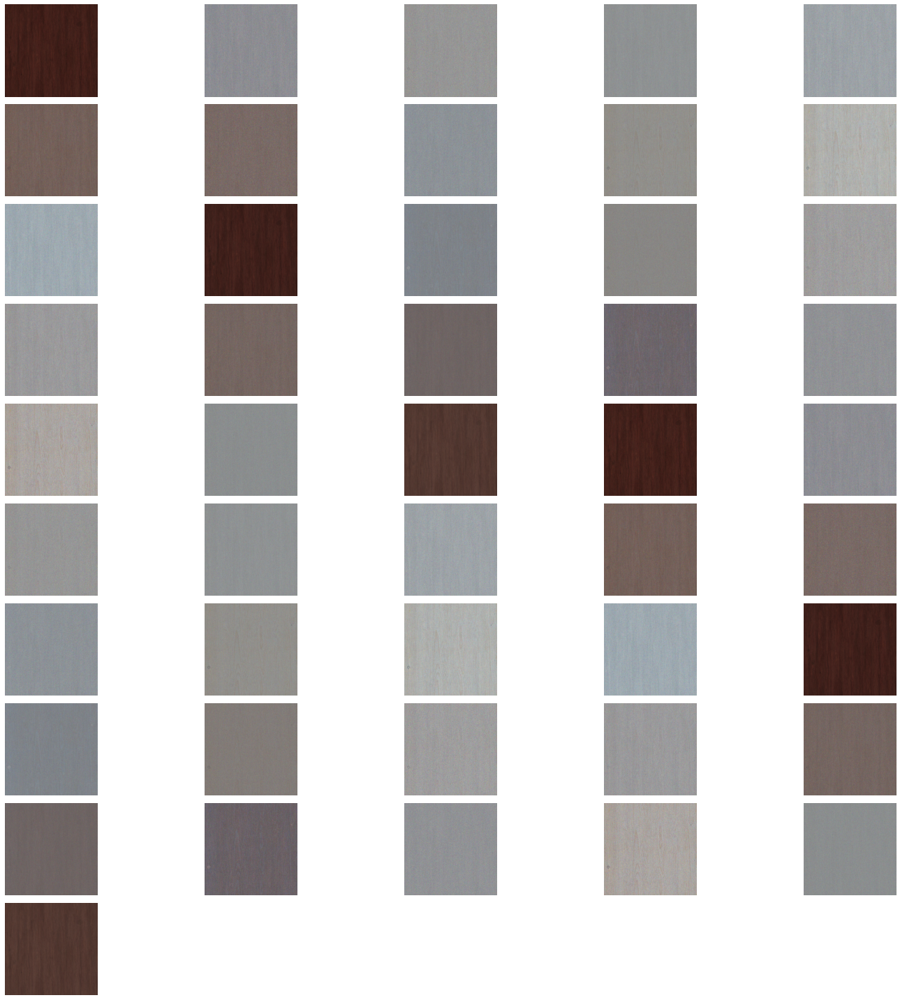

In [ ]:
plot_multiple_images(wood_dec_preds,5)
#save_fig("vae_generated_images_plot", tight_layout=False)



### CNF Matrix Functions

In [ ]:
def build_cnf_matrix(predictions,generator):
  '''
  Returns a CMF matrix from predicted and actual labels for a prediction imnage set
  '''

  y_pred = np.argmax(predictions, axis=1)

  y_actual_lst = [(np.argmax(generator[i][1], axis = 1)) for i in range(len(generator.labels)//generator.batch_size + 1)]
  y_actual_arr = np.append(np.stack(y_actual_lst[:-1]).flatten(),y_actual_lst[-1])

  return np.round(confusion_matrix(y_actual_arr, y_pred),2)

In [ ]:
def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues,
                          figsize=(10,10)):
  """
  This function prints and plots the confusion matrix.
  Normalization can be applied by setting `normalize=True`.
  """
  fig, ax = plt.subplots(figsize=figsize)

  if normalize:
      cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
      cm = cm * 100
      print("\nNormalized confusion matrix")
  else:
      print('\nConfusion matrix, without normalization')
  print(cm)
  print ()

  plt.imshow(cm, interpolation='nearest', cmap=cmap)
  plt.title(title)
  plt.colorbar()
  tick_marks = np.arange(len(classes))
  plt.xticks(tick_marks, classes, rotation=90)
  plt.yticks(tick_marks, classes)

  fmt = '.0f' if normalize else 'd'
  thresh = cm.max() / 2.
  for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
      plt.text(j, i, format(cm[i, j], fmt),
                horizontalalignment="center",
                color="white" if cm[i, j] > thresh else "black")

  plt.tight_layout()
  plt.ylabel('True label')
  plt.xlabel('Predicted label')
  plt.show()

In [ ]:
xcp_cnf_mat = build_cnf_matrix(xception_preds,test_set)


Normalized confusion matrix
[[33.33333333 16.66666667 11.11111111  0.         33.33333333  5.55555556]
 [ 9.72222222 77.77777778  8.33333333  0.          2.77777778  1.38888889]
 [11.42857143  8.57142857 60.          0.         11.42857143  8.57142857]
 [ 2.5        20.         17.5        30.         22.5         7.5       ]
 [ 4.10958904  4.10958904  6.84931507  8.21917808 72.60273973  4.10958904]
 [ 2.85714286  0.          0.          0.          2.85714286 94.28571429]]



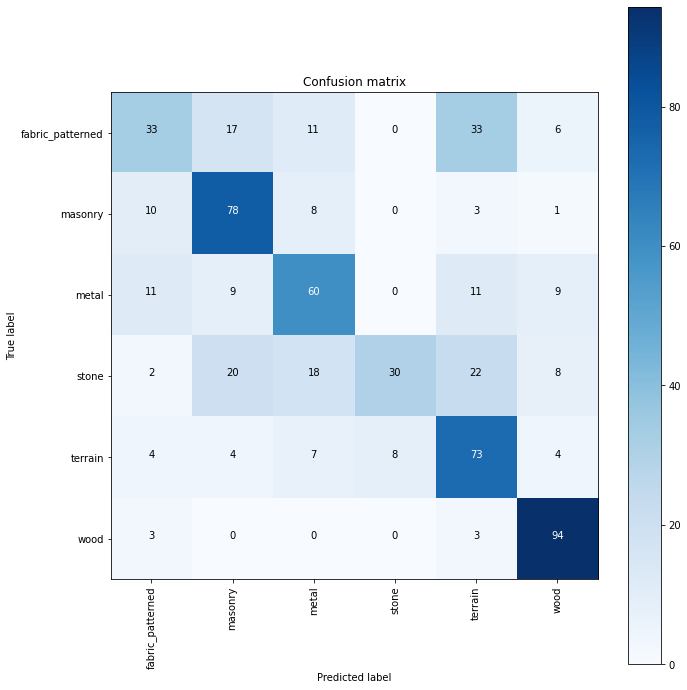

In [ ]:
xcp_cnf_plot = plot_confusion_matrix(xcp_cnf_mat,list_features,normalize=True)

In [ ]:
%load_ext tensorboard

In [ ]:
%tensorboard --logdir 'drive/MyDrive/capstone-3/callbacks/logs/'

<IPython.core.display.Javascript object>

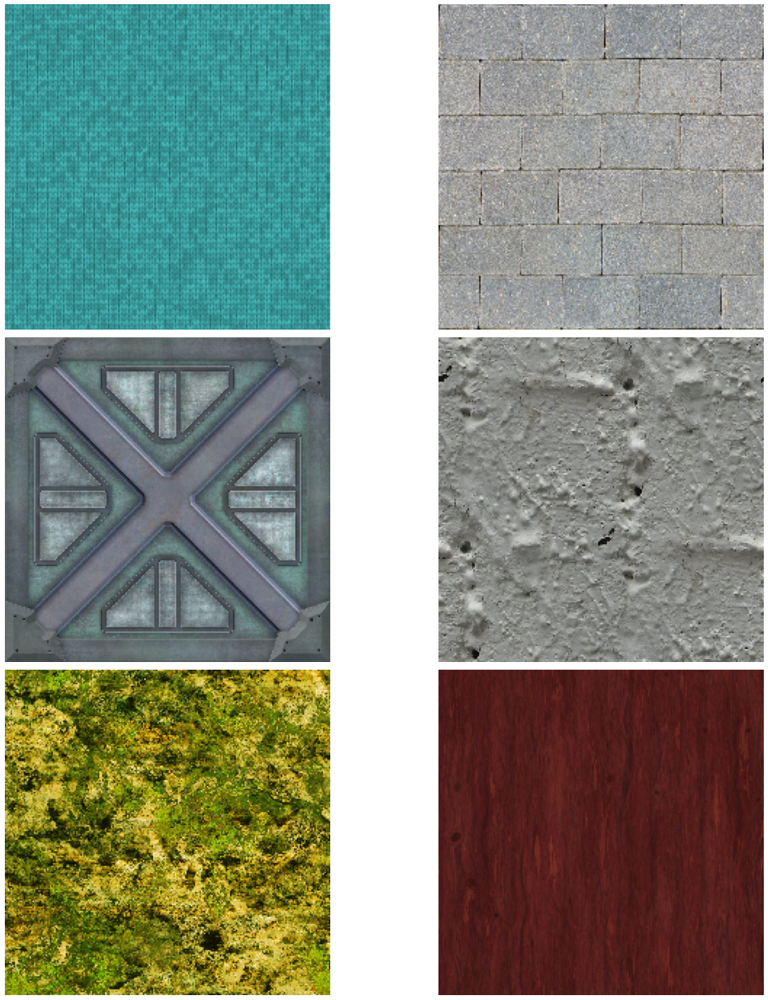

In [ ]:
plot_multiple_images(conf_imgs,2)

In [ ]:
def image_plot(rows,batch,predictions,features,save=False,save_dir='',cols=32,figsize=(4,4)):  
    """ 
    Plots images with thier predicted class and actual class
    Used after model has been fit to see results of test data
    
    Parameters: 
        rows (int): number of rows for the images displayed
        batch (ImageDataGenerator): test batch of pictures that will be predicted in model
        model : the model training images have been trained on to be used to predict test images
        cols (int) : number of columns displayed ( set to batch size )
        features (list): list of features to show
    
    Returns: 
        plot: Plot of images with their predicted class and their actual class
    """
    fig, axs = plt.subplots(rows,cols,figsize=(cols * figsize[0],rows * figsize[1]))

    for i in range(rows):
        images, labels = next(batch)
        for j, pic in enumerate(images):
            title = 'Predicted:' + ' ' + features[list(predictions[j]).index(predictions[j].max())] + ' ' + '\n' + 'Actual:' + ' ' + features[list(labels[j]).index(1)] + '\n' + 'Confidence:' + str(predictions[j].max().round(2))
            if rows > 1:
                axs[i,j].imshow(pic.astype('uint8'))
                axs[i,j].set_title(title,color='blue')
                axs[i,j].axis('off')
                if features[list(predictions[j]).index(predictions[j].max())] != features[list(labels[j]).index(1)]:
                  axs[i,j].set_title(title,color='red')
            else:
                axs[j].imshow(pic.astype('uint8'))
                axs[j].set_title(title,color='blue')
                if features[list(predictions[j]).index(predictions[j].max())] != features[list(labels[j]).index(1)]:
                  axs[j].set_title(title,color='red')
                axs[j].axis('off')


    plt.tight_layout()
    plt.show()

    if save == True:
      plt.savefig(save_dir,dpi=150,transparent=True)

IndexError: ignored

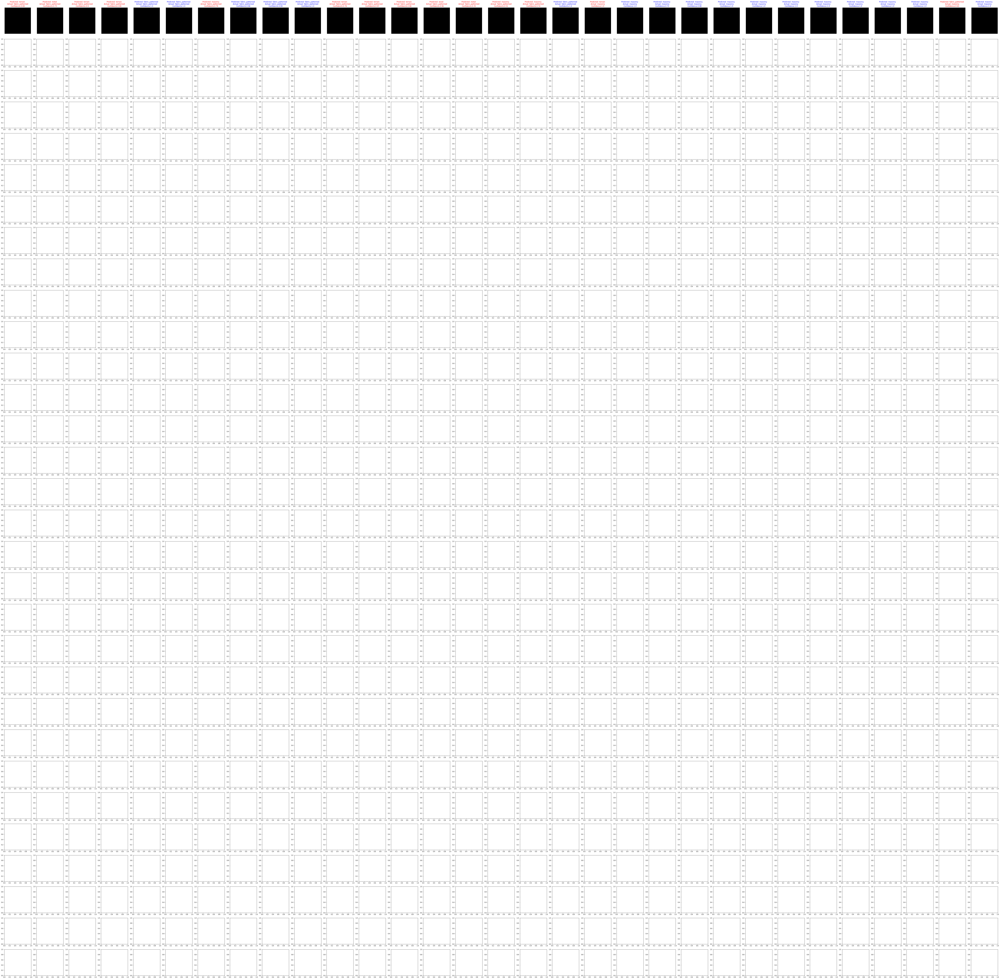

In [ ]:
image_plot(31,test_unaltered,xception_preds,features=list_features,cols=31)